<a href="https://colab.research.google.com/github/sivabathina/Object-detection/blob/main/YOLOv5_hyperparameter_optimisation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# 

**This notebook compares the performance of the hyperparameter tuning on the SGD and ADAM optimisers **

# **Note:** It some times shows errors while importing the packages and cloning YOLOv5 repo from github, please run the two cells again if it happens.



In [ ]:
# importing required packages
import torch
from IPython.display import Image  # for displaying images
import os 
import random
import shutil
from sklearn.model_selection import train_test_split
import xml.etree.ElementTree as ET
from xml.dom import minidom
from tqdm import tqdm
from PIL import Image, ImageDraw
import numpy as np
import matplotlib.pyplot as plt
!pip install pyyaml

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
# Cloning YOLOv5 repo and installing dependencies
!git clone https://github.com/ultralytics/yolov5 
!pip install -U -r yolov5/requirements.txt  # install dependencies

fatal: destination path 'yolov5' already exists and is not an empty directory.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cached protobuf-3.20.1-cp37-cp37m-manylinux_2_5_x86_64.manylinux1_x86_64.whl (1.0 MB)


In [ ]:
# checking directory
%cd /content/yolov5

/content/yolov5


In [ ]:
# checking torch version


print('Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

Using torch 1.12.1+cu113 _CudaDeviceProperties(name='Tesla V100-SXM2-16GB', major=7, minor=0, total_memory=16160MB, multi_processor_count=80)


In [ ]:
# Enonkishu data through roboflow 
!curl -L "https://app.roboflow.com/ds/pvuZbTSOOk?key=vk7cV4COsB" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   901  100   901    0     0   2604      0 --:--:-- --:--:-- --:--:--  2604
100 48.8M  100 48.8M    0     0  18.1M      0  0:00:02  0:00:02 --:--:-- 22.7M
Archive:  roboflow.zip
 extracting: README.dataset.txt      
 extracting: README.roboflow.txt     
 extracting: data.yaml               
   creating: test/
   creating: test/images/
 extracting: test/images/ENO_S1_B02_R1_IMAG0050_JPG.rf.d110a6be6da7ff2eaee04baafa202d4d.jpg  
 extracting: test/images/ENO_S1_B02_R1_IMAG0074_JPG.rf.4915a327d25cbab618f5029c01f57065.jpg  
 extracting: test/images/ENO_S1_B02_R1_IMAG0082_JPG.rf.897fe652105aa7765240e840239d807d.jpg  
 extracting: test/images/ENO_S1_B02_R1_IMAG0083_JPG.rf.cae931c98d0ba886fdb21e7a1962c4e9.jpg  
 extracting: test/images/ENO_S1_B02_R1_IMAG0149_JPG.rf.82ef30cfd353a6b4343d3f28e6b0960e.jpg  
 extracting: test/images/ENO_S1_

In [ ]:
# defining number of classes, data.yaml contains the information about number of classes and their labels required for this project
import yaml
with open("data.yaml", 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])

In [ ]:
# importing required packages to rewrite variables
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))

In [ ]:
# current path, that will be changed in the next cell
%cat data.yaml

train: ../train/images
val: ../valid/images

nc: 11
names: ['Baboon', 'Dikdik', 'Elephant', 'Giraffe', 'Hippopotamus', 'Hyena', 'Impala', 'Leopard', 'Warthog', 'Wildebeest', 'Zebra']

In [ ]:
# BCanging the data configuration for right path to the dataset
%%writetemplate /content/yolov5/data.yaml

train: ./train/images
val: ./valid/images

nc: 11
names: ['Baboon', 'Dikdik', 'Elephant', 'Giraffe', 'Hippopotamus', 'Hyena', 'Impala', 'Leopard', 'Warthog', 'Wildebeest', 'Zebra']

In [ ]:
%cat data.yaml


train: ./train/images
val: ./valid/images

nc: 11
names: ['Baboon', 'Dikdik', 'Elephant', 'Giraffe', 'Hippopotamus', 'Hyena', 'Impala', 'Leopard', 'Warthog', 'Wildebeest', 'Zebra']

In [ ]:
with open(r'data.yaml') as file:
    # The FullLoader parameter handles the conversion from YAML
    # scalar values to Python the dictionary format
    labels_list = yaml.load(file, Loader=yaml.FullLoader)

    label_names = labels_list['names']

In [ ]:
print("Number of Classes are {}, whose labels are {} for this Object Detection project".format(num_classes,label_names))

Number of Classes are 11, whose labels are ['Baboon', 'Dikdik', 'Elephant', 'Giraffe', 'Hippopotamus', 'Hyena', 'Impala', 'Leopard', 'Warthog', 'Wildebeest', 'Zebra'] for this Object Detection project


In [ ]:
# YOLOv5x
%cat /content/yolov5/models/yolov5x.yaml

# YOLOv5 🚀 by Ultralytics, GPL-3.0 license

# Parameters
nc: 80  # number of classes
depth_multiple: 1.33  # model depth multiple
width_multiple: 1.25  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [64, 6, 2, 2]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 6, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 3, C3, [1024]],
   [-1, 1, SPPF, [1024, 5]],  # 9
  ]

# YOLOv5 v6.0 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]]

In [ ]:
# Modifying the the number of classes as per our datset (11), the rest stays exactly the same
%%writetemplate /content/yolov5/models/custom_yolov5x.yaml

# Parameters
nc: 11  # number of classes
depth_multiple: 1.33  # model depth multiple
width_multiple: 1.25  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [64, 6, 2, 2]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 6, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 3, C3, [1024]],
   [-1, 1, SPPF, [1024, 5]],  # 9
  ]

# YOLOv5 v6.0 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, C3, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, C3, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, C3, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]

# **YOLOv5x with default SGD optimiser**

In [ ]:

# Training the YOLOv5 withn the default SGD optimiser on 1000 epochs
%%time
%cd /content/yolov5/
!python train.py --img 416 --batch 20 --epochs 1000 --data './data.yaml' --cfg ./models/custom_yolov5x.yaml --weights '' --name SGD

/content/yolov5
train: weights=, cfg=./models/custom_yolov5x.yaml, data=./data.yaml, hyp=data/hyps/hyp.scratch-high.yaml, epochs=1000, batch_size=20, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=SGD, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
remote: Enumerating objects: 50, done.
remote: Counting objects: 100% (50/50), done.
remote: Compressing objects: 100% (26/26), done.
remote: Total 50 (delta 28), reused 44 (delta 24), pack-reused 0
Unpacking objects: 100% (50/50), done.
From https://github.com/ultralytics/yolov5
   5fe56fc..17564e1  classifier -> origin/classifier
github: up to date with https://github.com

GROUND TRUTH TRAINING DATA:


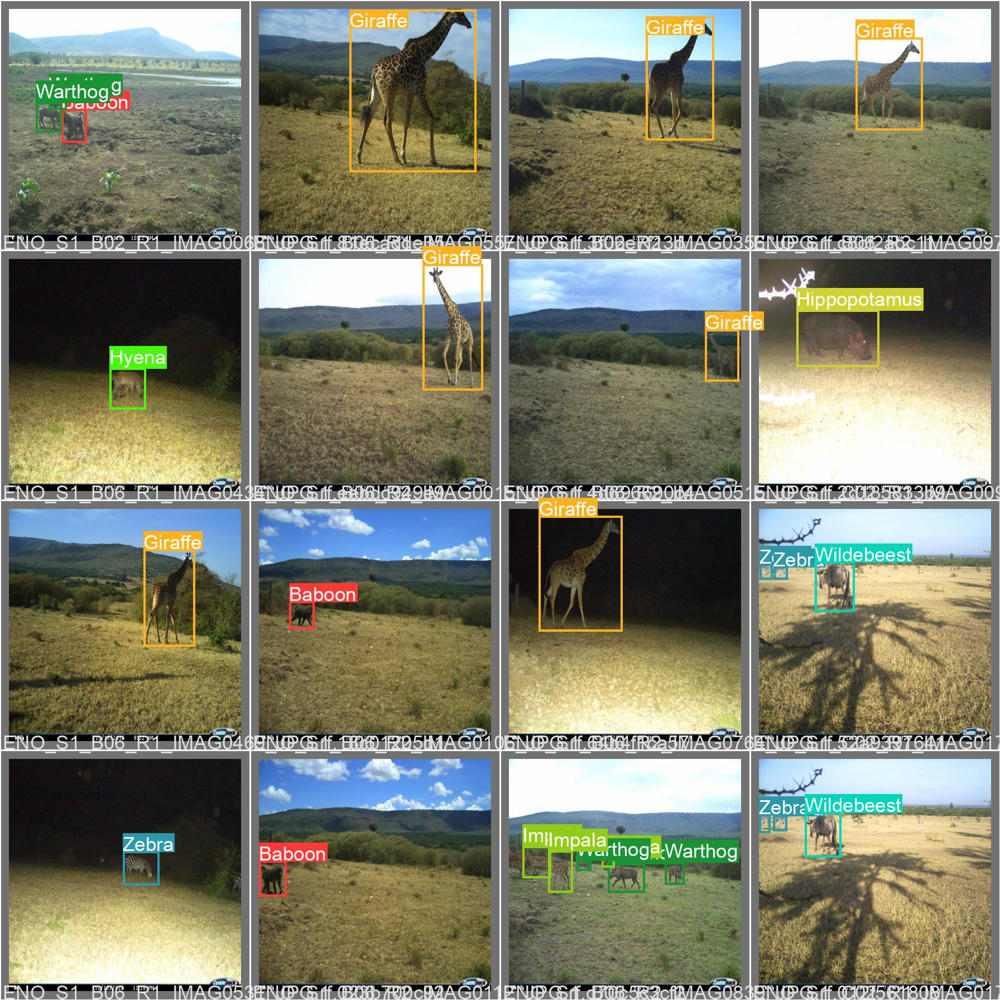

In [ ]:
# Display ground truth data

print("GROUND TRUTH TRAINING DATA:")
Image(filename='/content/yolov5/runs/train/SGD2/val_batch0_labels.jpg', width=900)

GROUND TRUTH AUGMENTED TRAINING DATA:


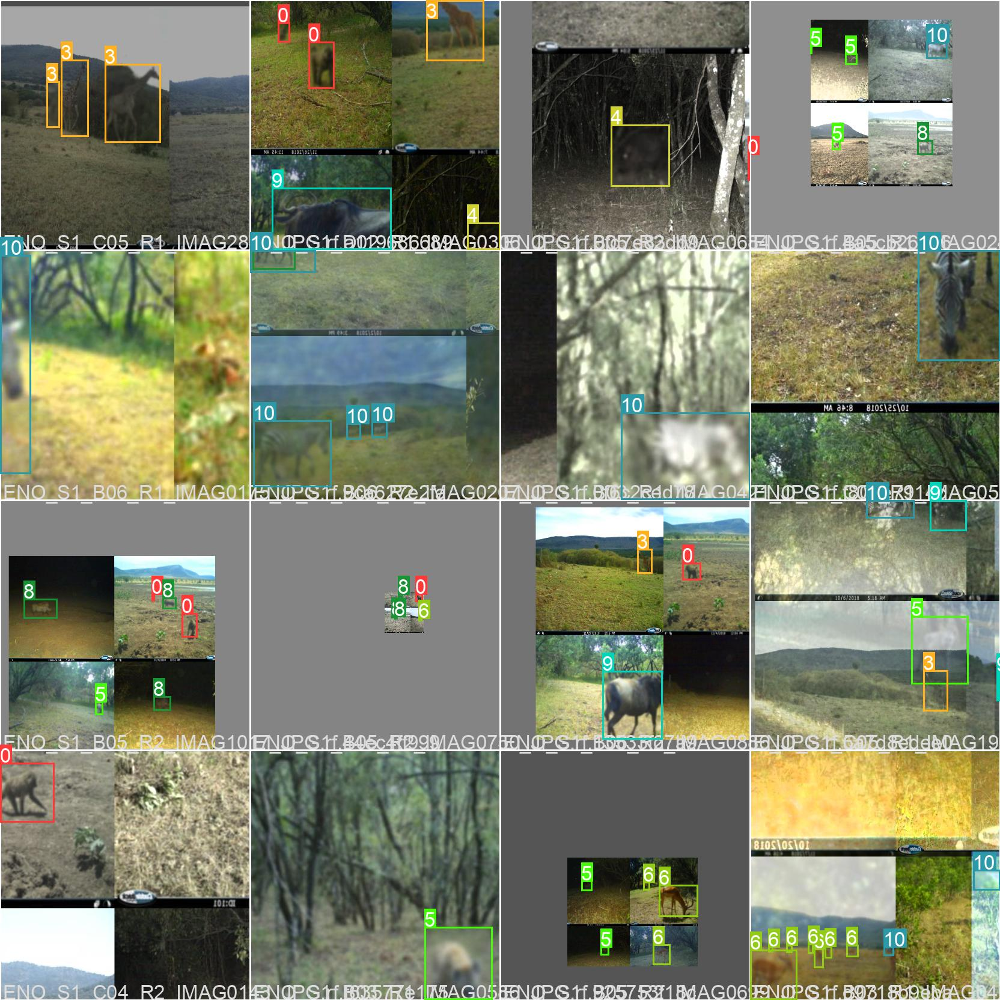

In [ ]:

# Below is the augmented training data.

print("GROUND TRUTH AUGMENTED TRAINING DATA:")
Image(filename='/content/yolov5/runs/train/SGD2/train_batch0.jpg', width=900)

In [ ]:
# Choosing the best weights and applying them on test data

%cd /content/yolov5/
!python detect.py --weights /content/yolov5/runs/train/SGD2/weights/best.pt --img 416 --conf 0.4 --source ./test/images

/content/yolov5
detect: weights=['/content/yolov5/runs/train/SGD2/weights/best.pt'], source=./test/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-391-g7639e4c Python-3.7.13 torch-1.12.1+cu113 CUDA:0 (Tesla V100-SXM2-16GB, 16160MiB)

Fusing layers... 
custom_YOLOv5x summary: 444 layers, 86240704 parameters, 0 gradients, 204.0 GFLOPs
image 1/87 /content/yolov5/test/images/ENO_S1_B02_R1_IMAG0050_JPG.rf.d110a6be6da7ff2eaee04baafa202d4d.jpg: 416x416 1 Warthog, Done. (0.017s)
image 2/87 /content/yolov5/test/images/ENO_S1_B02_R1_IMAG0074_JPG.rf.4915a327d25cbab618f5029c01f57065.jpg: 416x416 1 Warthog, Done. (0.017s)
image 3/87 /content/yolov5/te

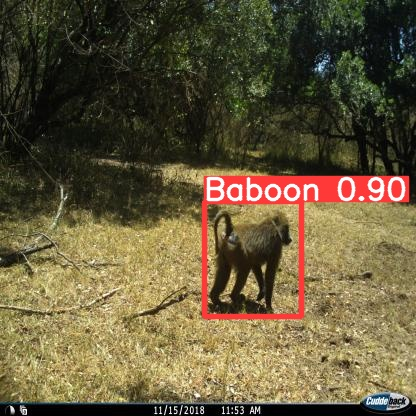




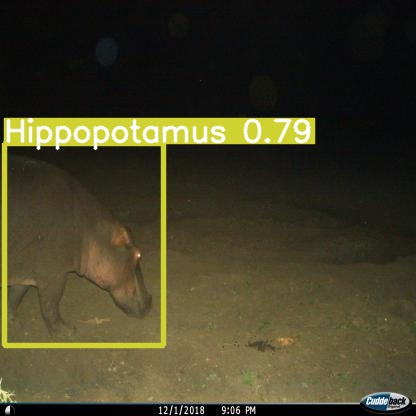




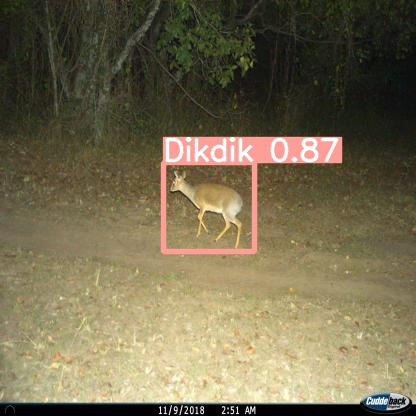




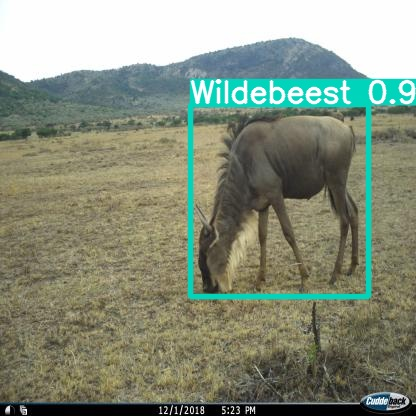




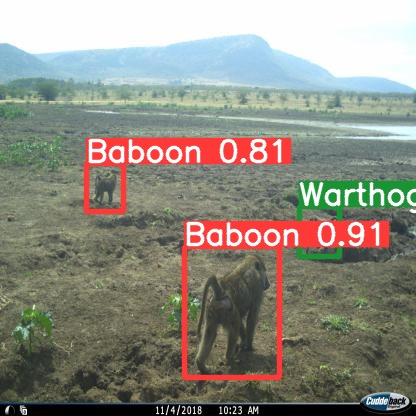




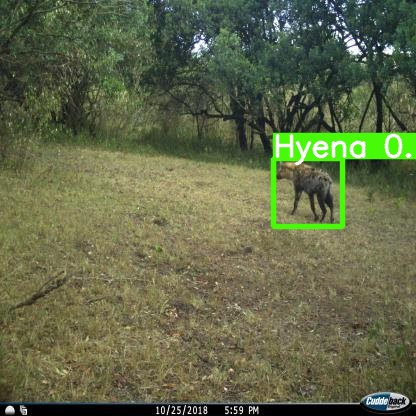




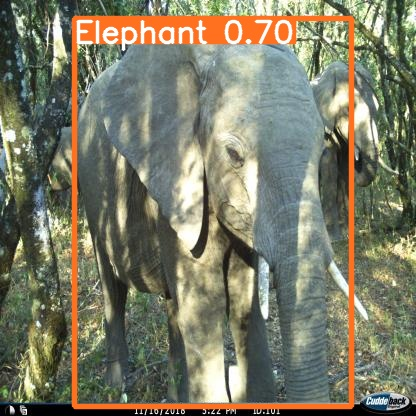




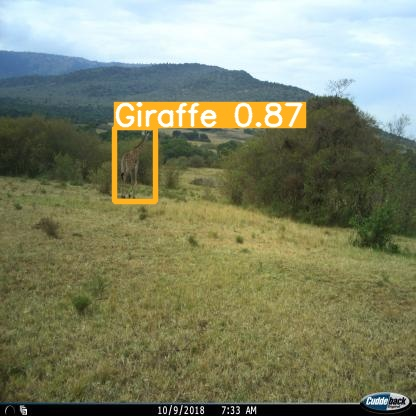




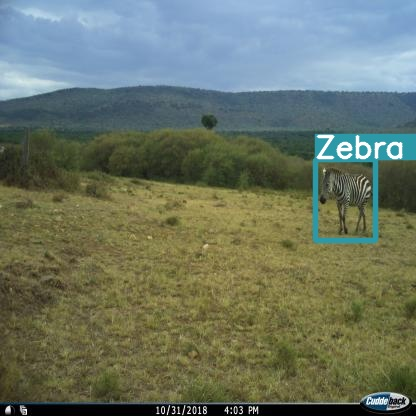




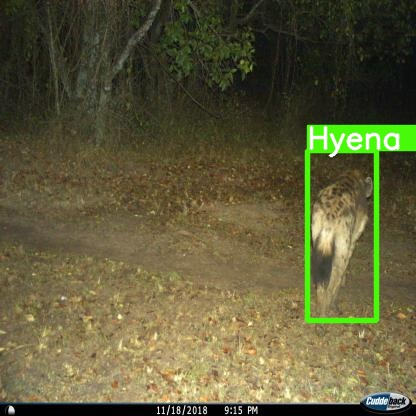




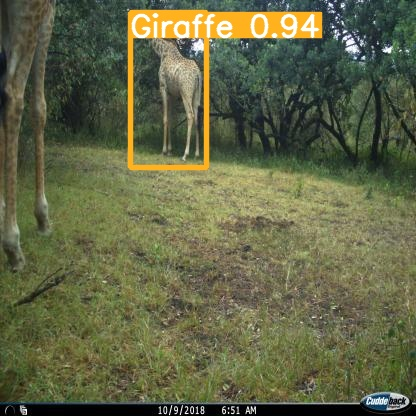




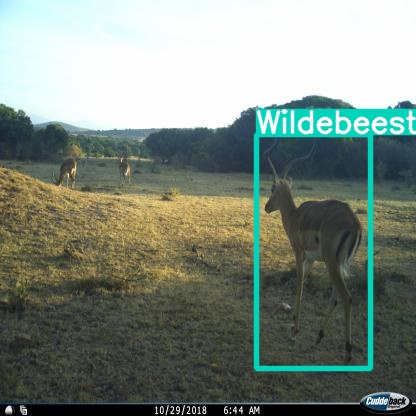




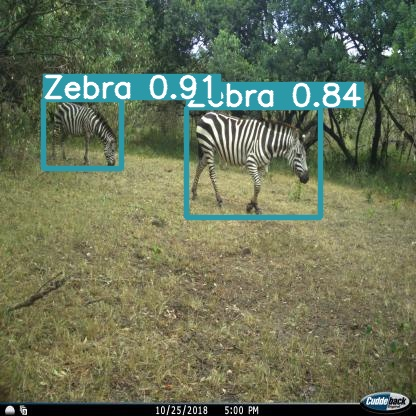




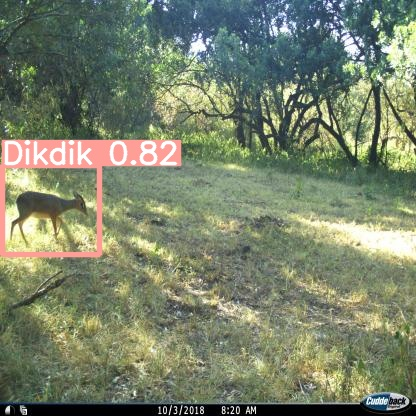




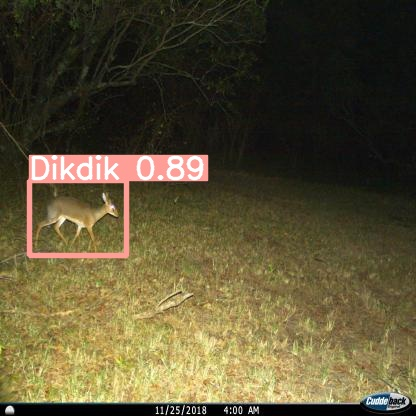




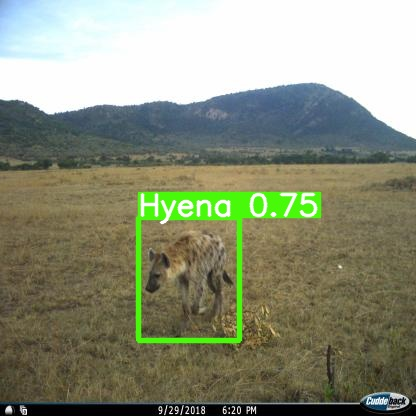




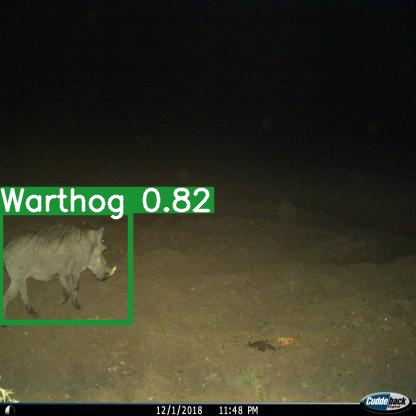




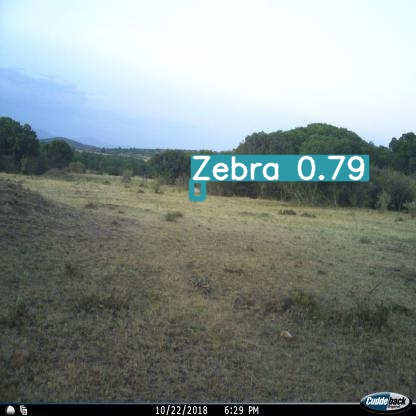




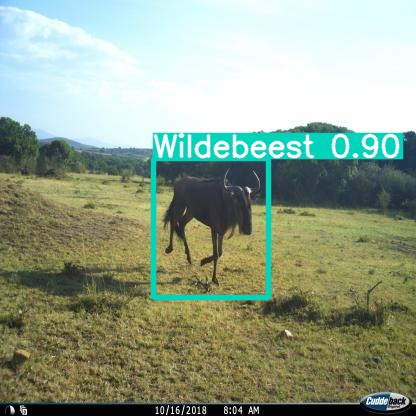




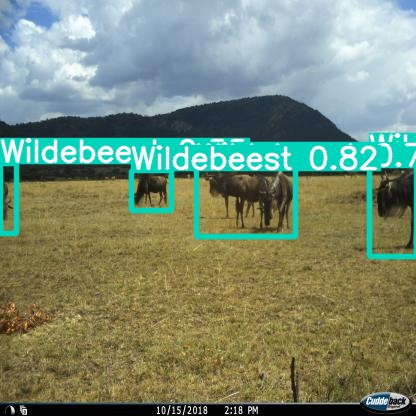




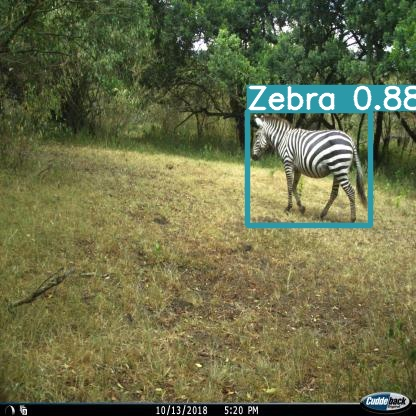




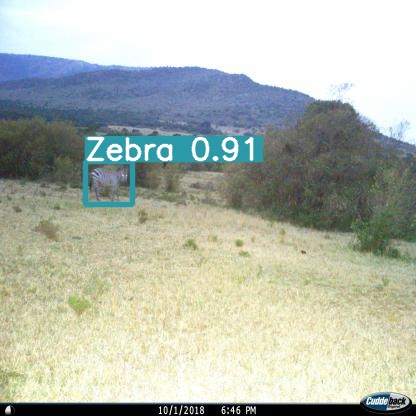




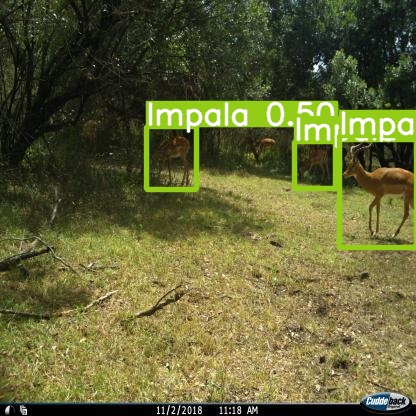




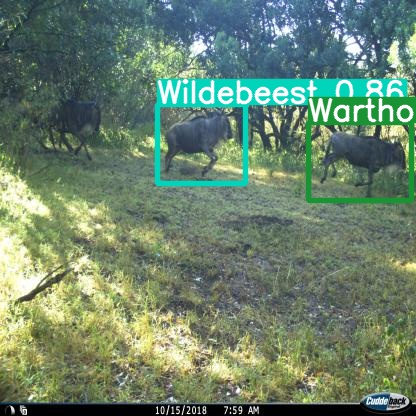




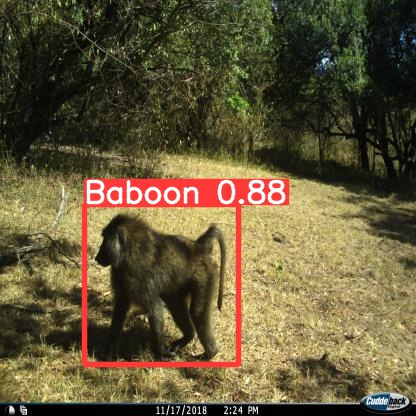




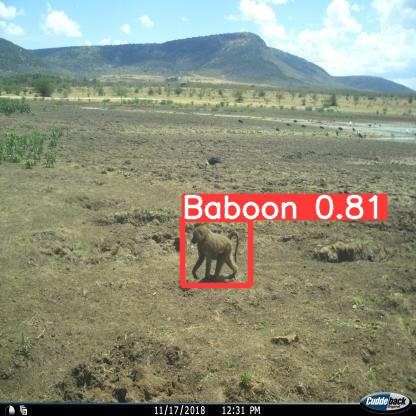




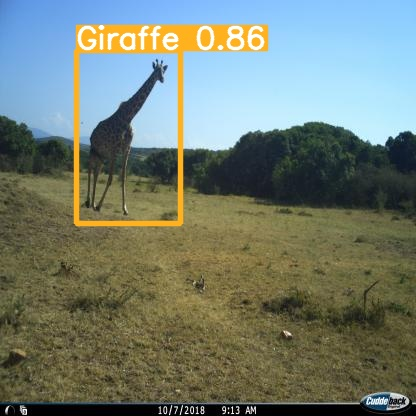




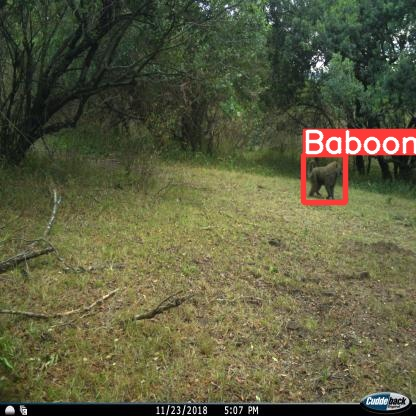




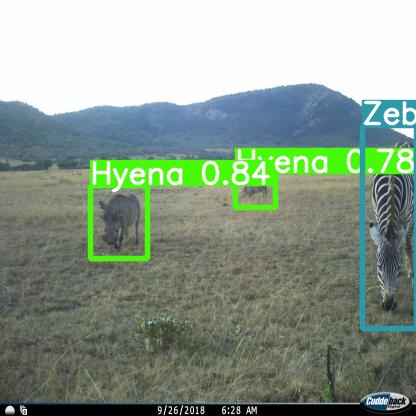




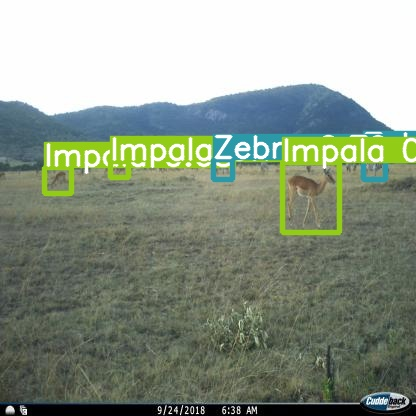




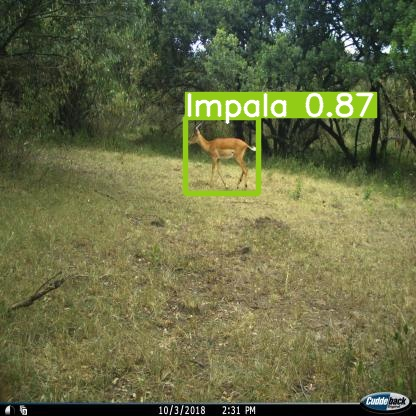




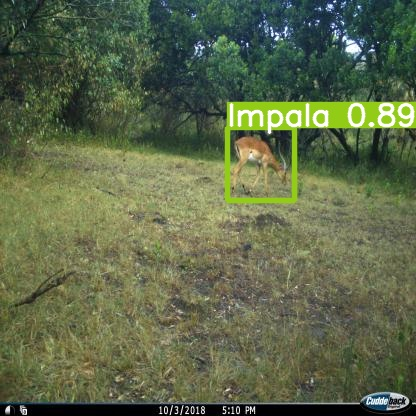




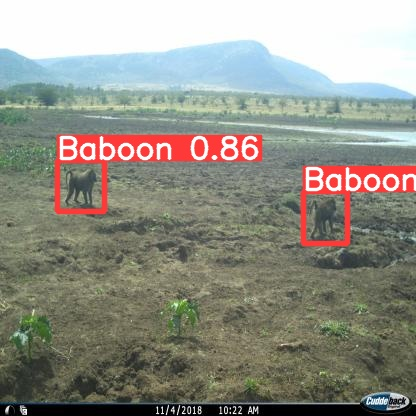




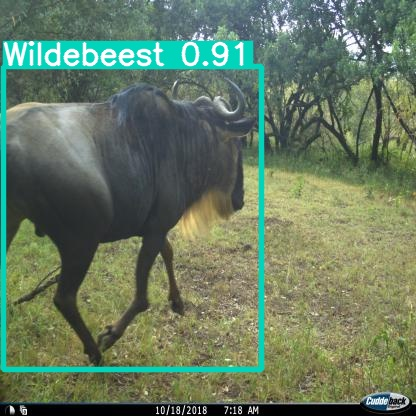




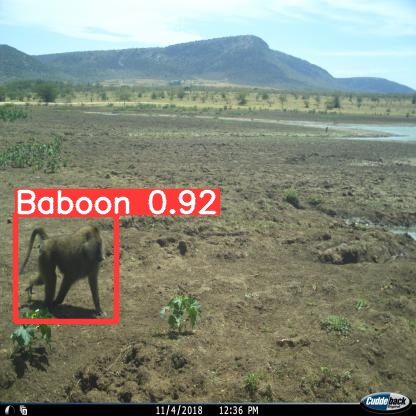




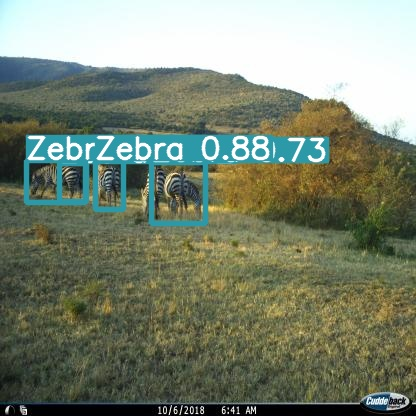




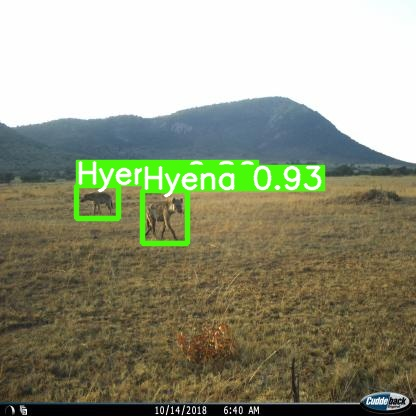




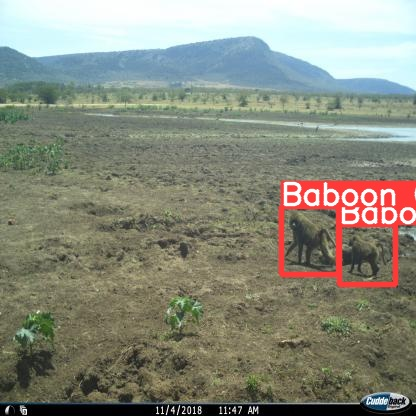




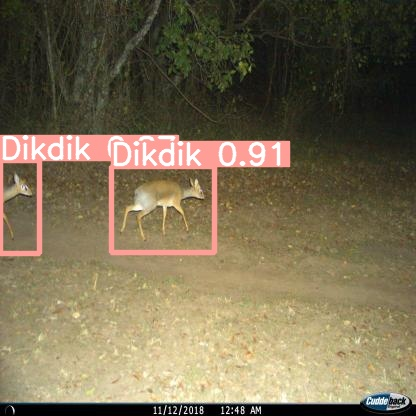




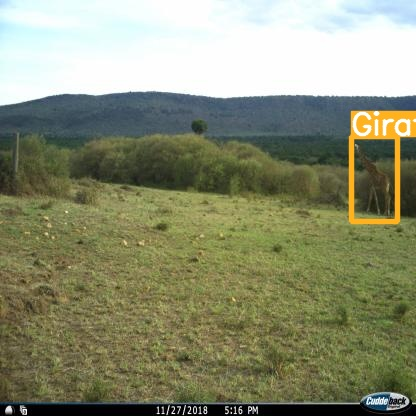




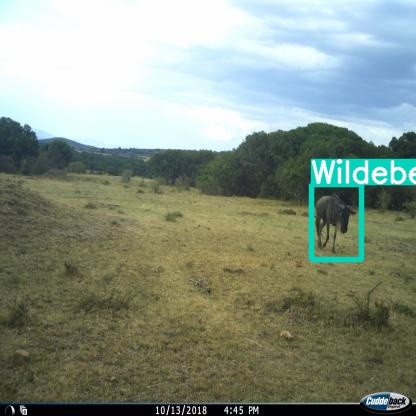




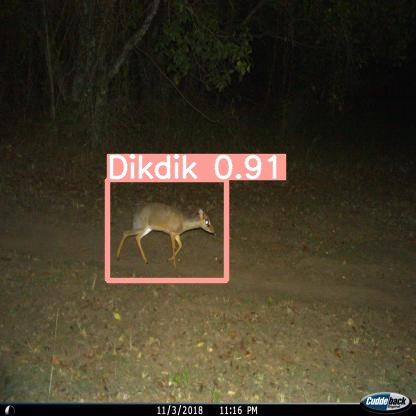




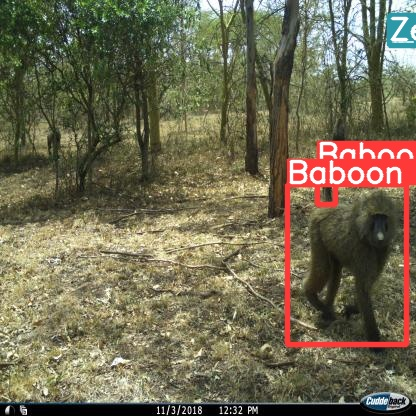




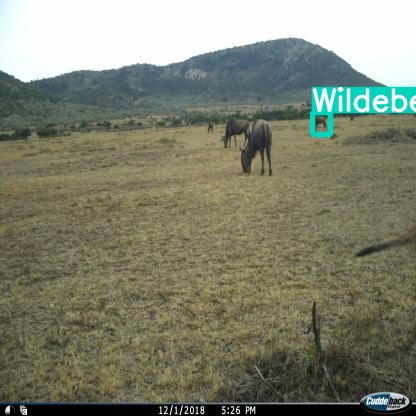




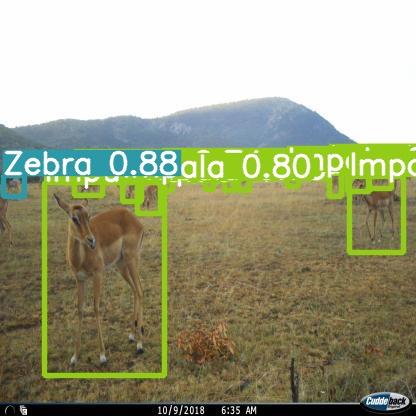




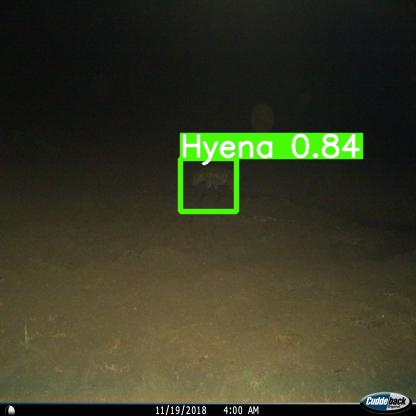




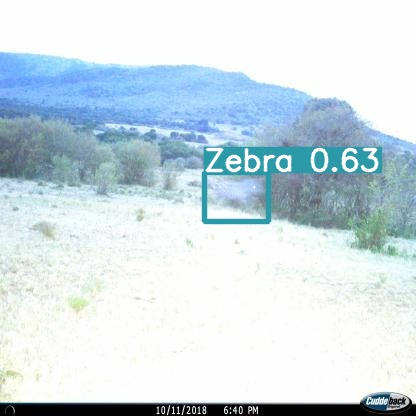




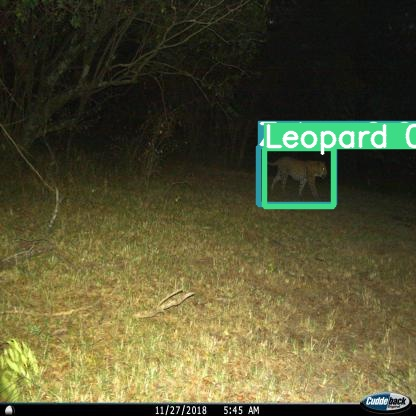




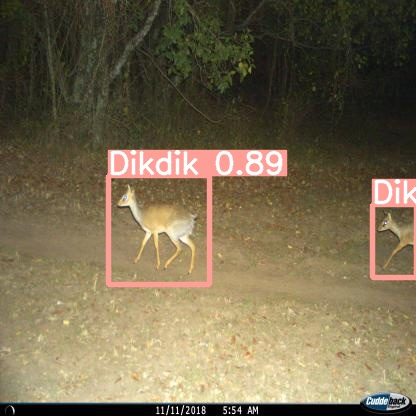




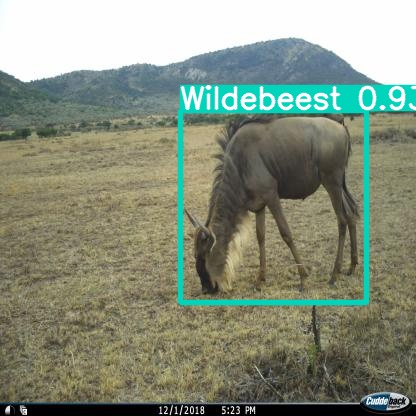




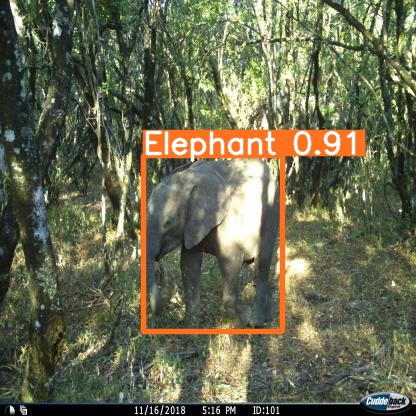




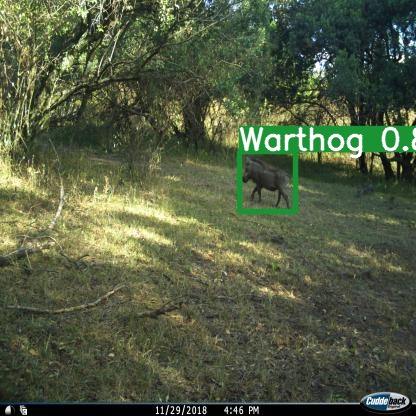




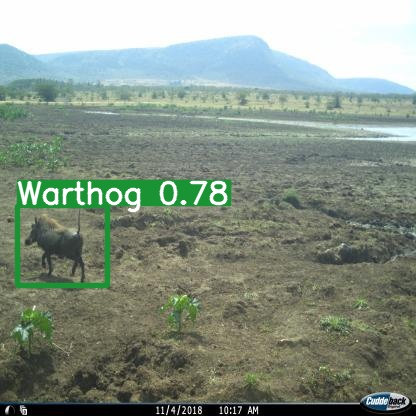




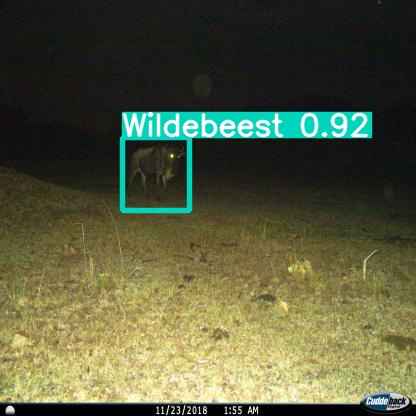




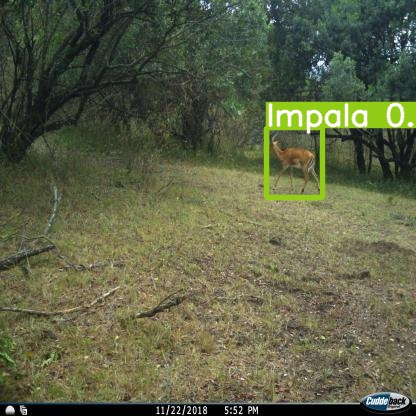




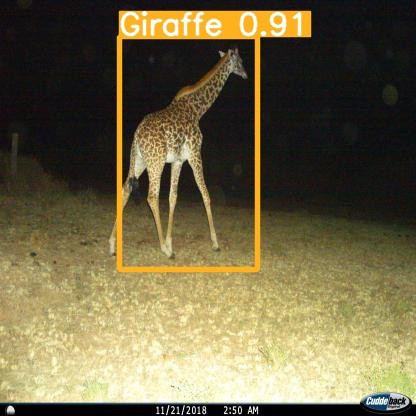




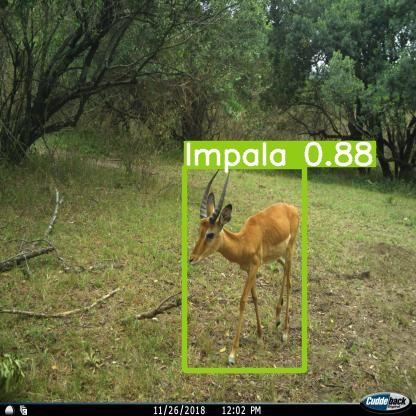




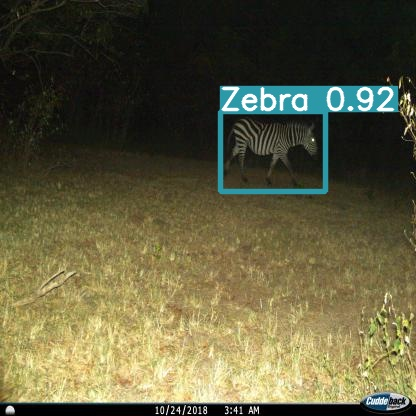




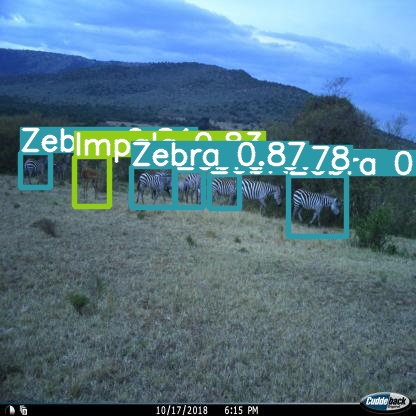




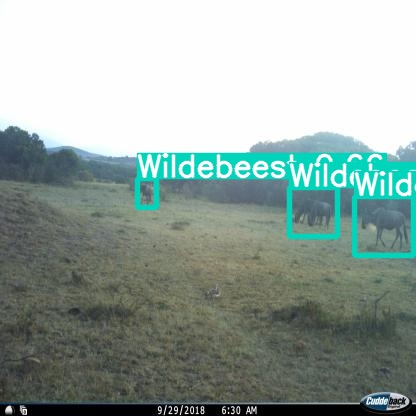




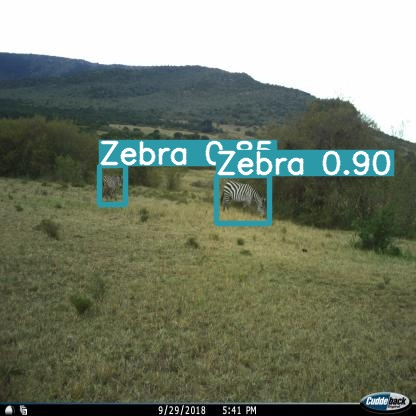




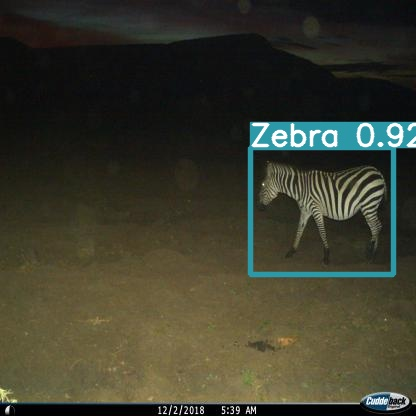




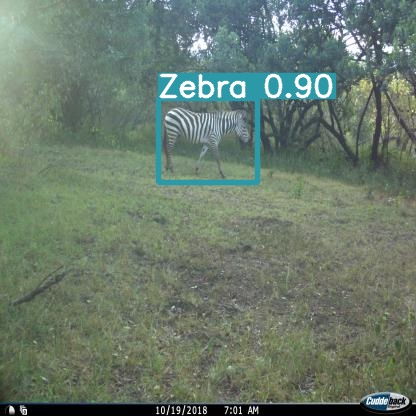




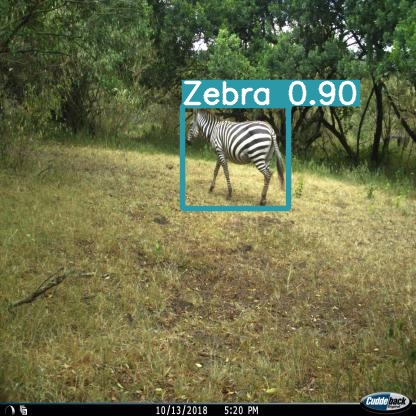




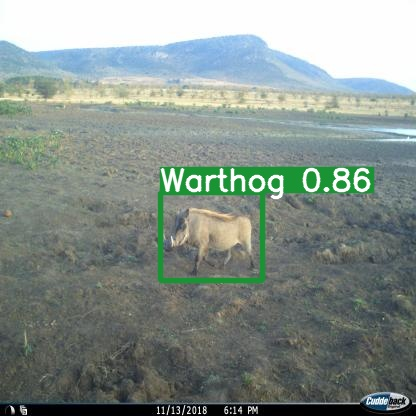




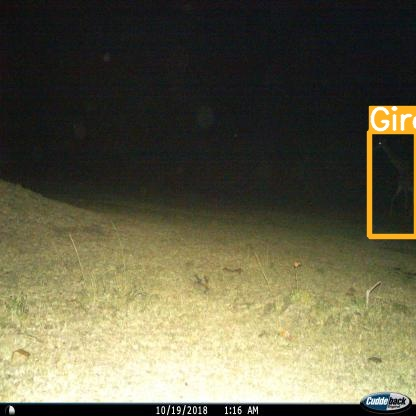




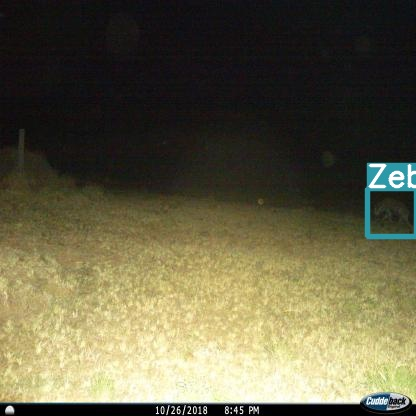




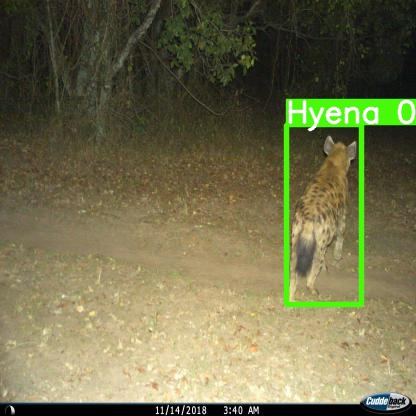




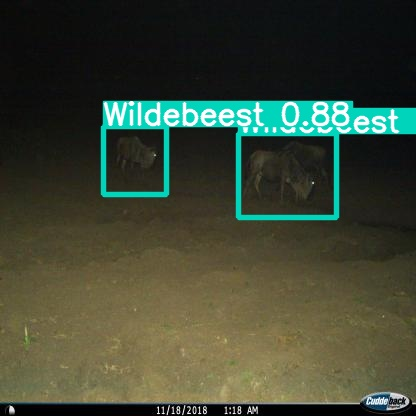




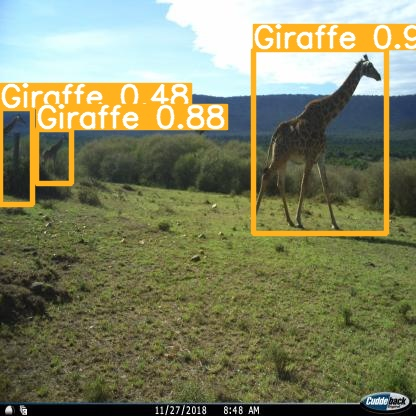




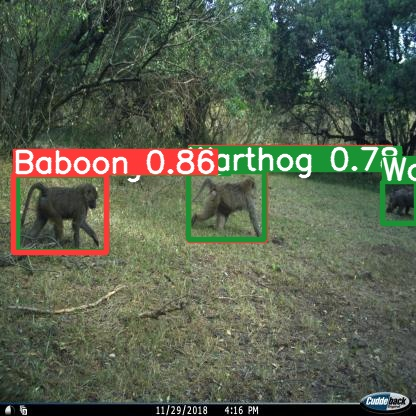




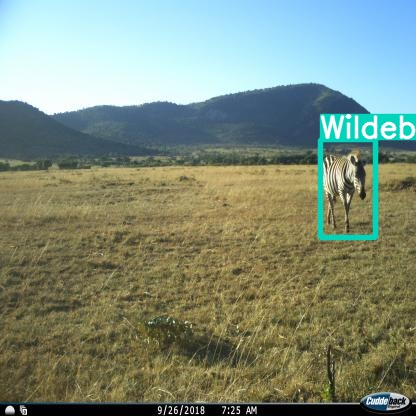




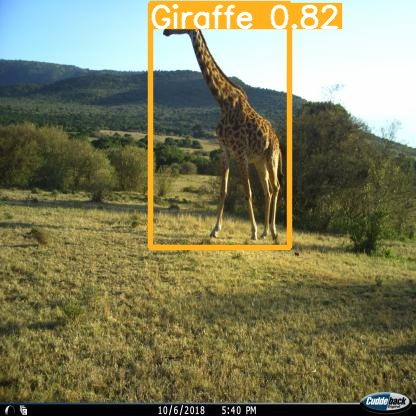




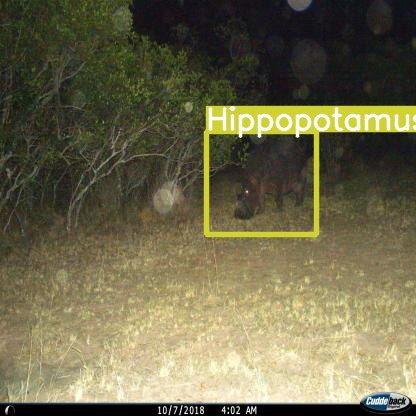




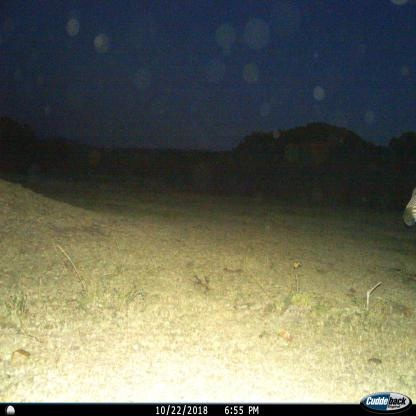




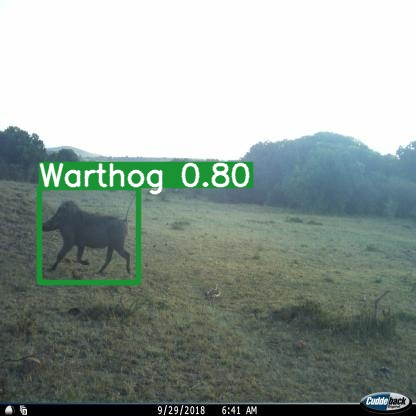




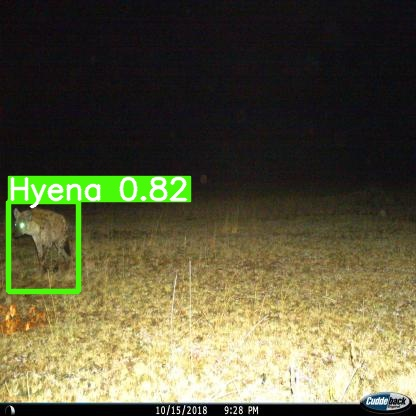




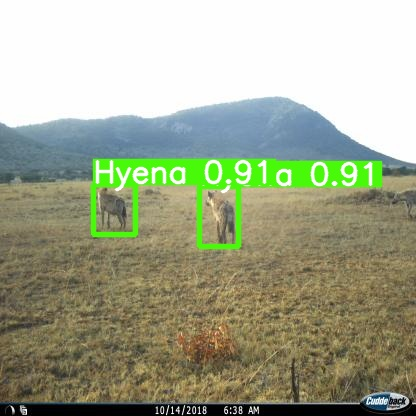




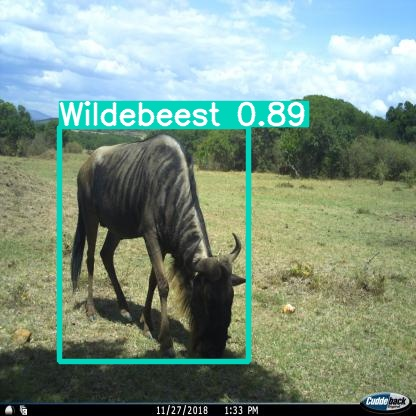




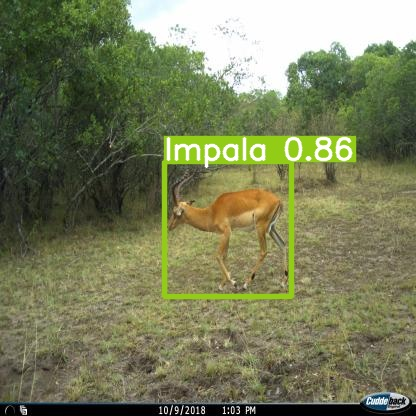




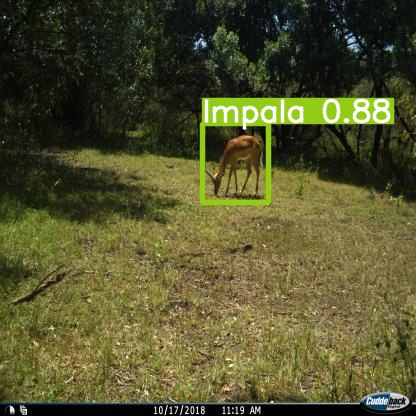




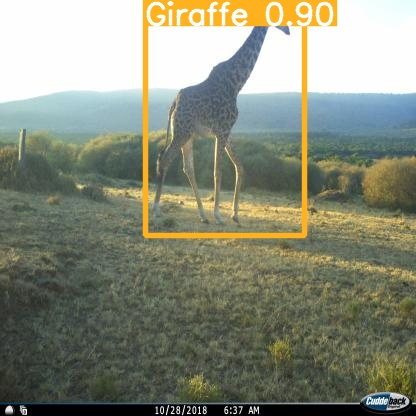




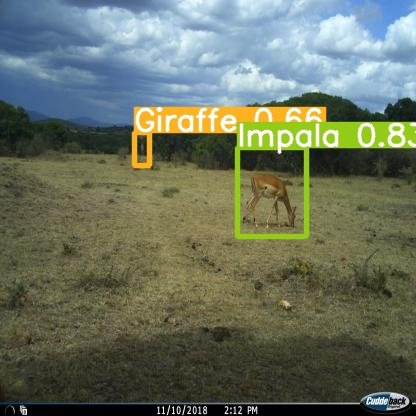




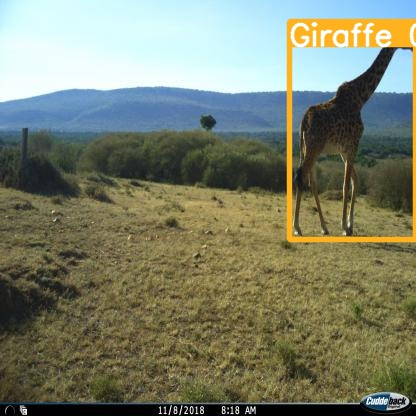




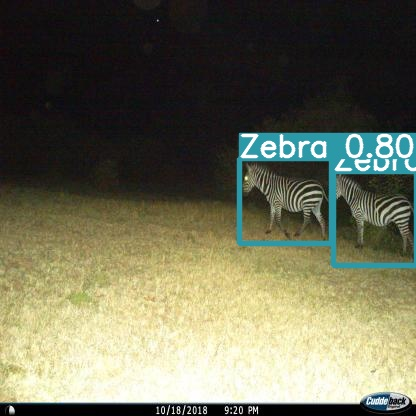




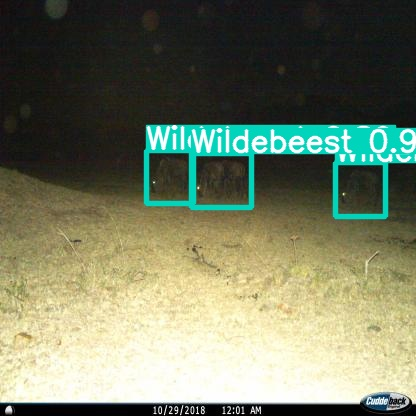




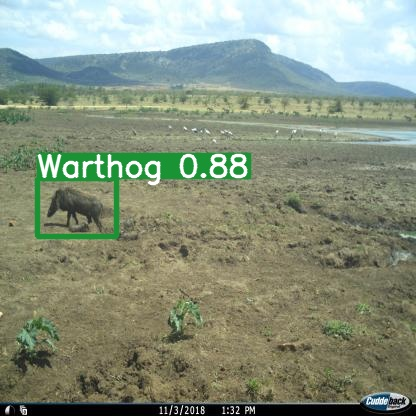




In [ ]:
#Displaying inference on ALL test images


import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName,width=400,height=400))
    print("\1")

In [ ]:
# hyperparameters yaml file modeified for tuning
%cat /content/yolov5/data/hyps/hyp.scratch-high.yaml

# YOLOv5 🚀 by Ultralytics, GPL-3.0 license
# Hyperparameters for high-augmentation COCO training from scratch
# python train.py --batch 32 --cfg yolov5m6.yaml --weights '' --data coco.yaml --img 1280 --epochs 300
# See tutorials for hyperparameter evolution https://github.com/ultralytics/yolov5#tutorials

lr0: 0.01  # initial learning rate (SGD=1E-2, Adam=1E-3)
lrf: 0.1  # final OneCycleLR learning rate (lr0 * lrf)
momentum: 0.937  # SGD momentum/Adam beta1
weight_decay: 0.0005  # optimizer weight decay 5e-4
warmup_epochs: 3.0  # warmup epochs (fractions ok)
warmup_momentum: 0.8  # warmup initial momentum
warmup_bias_lr: 0.1  # warmup initial bias lr
box: 0.05  # box loss gain
cls: 0.3  # cls loss gain
cls_pw: 1.0  # cls BCELoss positive_weight
obj: 0.7  # obj loss gain (scale with pixels)
obj_pw: 1.0  # obj BCELoss positive_weight
iou_t: 0.20  # IoU training threshold
anchor_t: 4.0  # anchor-multiple threshold
# anchors: 3  # anchors per output layer (0 to ignore)
fl_gamma: 0.0  # foc

# **YOLOv5x with ADAM optimiser with learning rate 0.0001**

In [ ]:

%%time
%cd /content/yolov5/
!python train.py  --img 416 --batch 20 --epochs 1000 --data './data.yaml' --cfg ./models/custom_yolov5x.yaml --weights '' --optimizer Adam --name lr0001Adam

/content/yolov5
train: weights=, cfg=./models/custom_yolov5x.yaml, data=./data.yaml, hyp=data/hyps/hyp.scratch-high.yaml, epochs=1000, batch_size=20, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=Adam, sync_bn=False, workers=8, project=runs/train, name=lr0001Adam, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-391-g7639e4c Python-3.7.13 torch-1.12.1+cu113 CUDA:0 (Tesla V100-SXM2-16GB, 16160MiB)

hyperparameters: lr0=0.0001, lrf=0.1, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.3, cls_pw=1.0, obj=0.7, obj_pw=1.0, iou_t=0.2, ancho

# **YOLOv5x with ADAM optimiser with learning rate 0.001**





In [ ]:
%%time
%cd /content/yolov5/
!python train.py  --img 416 --batch 20 --epochs 1000 --data './data.yaml' --cfg ./models/custom_yolov5x.yaml --weights '' --optimizer Adam --name lr001Adam

/content/yolov5
train: weights=, cfg=./models/custom_yolov5x.yaml, data=./data.yaml, hyp=data/hyps/hyp.scratch-high.yaml, epochs=1000, batch_size=20, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=Adam, sync_bn=False, workers=8, project=runs/train, name=lr001Adam, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
remote: Enumerating objects: 67, done.
remote: Counting objects: 100% (67/67), done.
remote: Compressing objects: 100% (31/31), done.
remote: Total 55 (delta 38), reused 41 (delta 24), pack-reused 0
Unpacking objects: 100% (55/55), done.
From https://github.com/ultralytics/yolov5
   59e1300..b7f3016  classifier -> origin/classifier
github: up to date with https://git

# YOLOv5x with ADAM optimiser with learning rate **0.01**

In [ ]:
%%time
%cd /content/yolov5/
!python train.py  --img 416 --batch 20 --epochs 1000 --data './data.yaml' --cfg ./models/custom_yolov5x.yaml --weights '' --optimizer Adam --name lr01Adam

/content/yolov5
train: weights=, cfg=./models/custom_yolov5x.yaml, data=./data.yaml, hyp=data/hyps/hyp.scratch-high.yaml, epochs=1000, batch_size=20, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=Adam, sync_bn=False, workers=8, project=runs/train, name=lr01Adam, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
remote: Enumerating objects: 49, done.
remote: Counting objects: 100% (49/49), done.
remote: Compressing objects: 100% (27/27), done.
remote: Total 49 (delta 31), reused 35 (delta 22), pack-reused 0
Unpacking objects: 100% (49/49), done.
From https://github.com/ultralytics/yolov5
   7639e4c..3fc8999  master     -> origin/master
   b7f3016..b41070b  classifier -> origi

# **Comparing performance of all the above models**

In [ ]:
# Starting tensorboard

%load_ext tensorboard
%tensorboard --logdir /content/yolov5/runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 5075), started 6:06:15 ago. (Use '!kill 5075' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
# Overl all SGD with default parameters performed better than the rest